# **Segundo ETL**
--------------------------------------------------------

# **Librerias**

In [5]:
import pandas as pd
import pyarrow.parquet as pq

# **DataFrame user reviews**
-----------------------------------------------

In [3]:
#cargamos el DataFrame
aur = pq.read_table('data/australian_user_reviews.parquet').to_pandas()

In [4]:
#Eliminamos la columna 'user_url' que no tiene importancia en este caso
aur = aur.drop(['user_url'], axis=1)

In [5]:
#separamos la columna 'reviews' con la funcion 'explode'
df_aur = aur.explode('reviews', ignore_index=True)
df_aur = pd.concat([df_aur['user_id'], df_aur['reviews'].apply(pd.Series)], axis=1)
df_aur.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59333 entries, 0 to 59332
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   user_id      59333 non-null  object 
 1   funny        59305 non-null  object 
 2   helpful      59305 non-null  object 
 3   item_id      59305 non-null  object 
 4   last_edited  59305 non-null  object 
 5   posted       59305 non-null  object 
 6   recommend    59305 non-null  object 
 7   review       59305 non-null  object 
 8   0            0 non-null      float64
dtypes: float64(1), object(8)
memory usage: 4.1+ MB


In [6]:
#eliminamos las filas, columnas nulas y datos irrelevantes
df_aur.dropna(subset=['funny','posted', 'last_edited','item_id','helpful','recommend','review'] ,how='all', inplace=True)
df_aur.dropna(axis=1 ,how='all', inplace=True)
df_aur.dropna(axis=0 ,how='all', inplace=True)
df_aur

,user_id,funny,helpful,item_id,last_edited,posted,recommend,review
0,76561197970982479,,No ratings yet,1250,,"Posted November 5, 2011.",True,Simple yet with great replayability. In my opi...
1,76561197970982479,,No ratings yet,22200,,"Posted July 15, 2011.",True,It's unique and worth a playthrough.
2,76561197970982479,,No ratings yet,43110,,"Posted April 21, 2011.",True,Great atmosphere. The gunplay can be a bit chu...
3,js41637,,15 of 20 people (75%) found this review helpful,251610,,"Posted June 24, 2014.",True,I know what you think when you see this title ...
4,js41637,,0 of 1 people (0%) found this review helpful,227300,,"Posted September 8, 2013.",True,For a simple (it's actually not all that simpl...
...,...,...,...,...,...,...,...,...
59328,76561198312638244,,No ratings yet,70,,Posted July 10.,True,a must have classic from steam definitely wort...
59329,76561198312638244,,No ratings yet,362890,,Posted July 8.,True,this game is a perfect remake of the original ...
59330,LydiaMorley,1 person found this review funny,1 of 2 people (50%) found this review helpful,273110,,Posted July 3.,True,had so much fun plaing this and collecting res...
59331,LydiaMorley,,No ratings yet,730,,Posted July 20.,True,:D


In [7]:
#se eliminan columnas irrelevantes segun los criterios solicitados
df_aur.drop(columns=['funny','posted','last_edited','helpful'], inplace=True)
df_aur.info()

<class 'pandas.core.frame.DataFrame'>
Index: 59305 entries, 0 to 59332
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   user_id    59305 non-null  object
 1   item_id    59305 non-null  object
 2   recommend  59305 non-null  object
 3   review     59305 non-null  object
dtypes: object(4)
memory usage: 2.3+ MB


# **Machine Learning**
---------------------------------------------

In [8]:
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer #Vader esta previamente entrenado.

# Descargar los recursos necesarios
nltk.download(['vader_lexicon', 'stopwords', 'punkt', 'names'])

# Crear un analizador de sentimientos
analyzer = SentimentIntensityAnalyzer()

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\toffer\AppData\Roaming\nltk_data...
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\toffer\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\stopwords.zip.
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\toffer\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping tokenizers\punkt.zip.
[nltk_data] Downloading package names to
[nltk_data]     C:\Users\toffer\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\names.zip.


In [9]:
# Analizamos el valor que nos da el NLP, nos da {'neg': valor , 'neu': valor  , 'pos': valor, 'compound': valor}, segun investigacion entendi que 
#compound hace referencia a la puntacion total de la oracion compuesta donde varia entre -1 y 1.

# Utilizo el compound para elegir su categoria si es malo (x < -0.5), neutro (-0,5 >= x <= 0,5) o positivo (x > 0,5), 
#redondeandolo a entero (-1, 0, 1). A ese mismo valor le sumo 1 asi queda con la referencia pedida del ejercicio malo 0, neutro 1, positivo 2.

df_aur['sentiment_analysis'] = df_aur['review'].map(lambda x: int(round(analyzer.polarity_scores(x)['compound'],0) + 1))


In [10]:
#eliminamos la columna review dado que ya no nos sera util
df_aur.drop(columns='review', inplace=True)
df_aur

,user_id,item_id,recommend,sentiment_analysis
0,76561197970982479,1250,True,2
1,76561197970982479,22200,True,1
2,76561197970982479,43110,True,2
3,js41637,251610,True,2
4,js41637,227300,True,2
...,...,...,...,...
59328,76561198312638244,70,True,2
59329,76561198312638244,362890,True,2
59330,LydiaMorley,273110,True,2
59331,LydiaMorley,730,True,2


# **Almacenamiento**
---------------------------------

In [13]:
#almacenamos el DataSet Limpio para su posterior uso en la API
df_aur.to_json('./data/data_clean/aur_clean.json.gz', compression='gzip')

# **Librerias**

In [14]:
import pyarrow as pa

# **DataSet User Items**
--------------------------------------------

In [15]:
#cargamos el DataFrame
df_aui = pq.read_table('data/australian_users_items.parquet').to_pandas()

In [16]:
#Eliminamos las columnas 'steam_id' y 'user_url'
df_aui.drop(columns=['steam_id', 'user_url'], inplace=True)
df_aui

,user_id,items_count,items
0,76561197970982479,277,"[{'item_id': '10', 'item_name': 'Counter-Strik..."
1,js41637,888,"[{'item_id': '10', 'item_name': 'Counter-Strik..."
2,evcentric,137,"[{'item_id': '1200', 'item_name': 'Red Orchest..."
3,Riot-Punch,328,"[{'item_id': '10', 'item_name': 'Counter-Strik..."
4,doctr,541,"[{'item_id': '300', 'item_name': 'Day of Defea..."
...,...,...,...
88305,76561198323066619,22,"[{'item_id': '413850', 'item_name': 'CS:GO Pla..."
88306,76561198326700687,177,"[{'item_id': '11020', 'item_name': 'TrackMania..."
88307,XxLaughingJackClown77xX,0,[]
88308,76561198329548331,7,"[{'item_id': '304930', 'item_name': 'Unturned'..."


# **Almacenamiento**
------------------------------------

In [17]:
#lo almacenamos para su posterior uso en la API
df_aui.to_csv('./data/data_clean/items.csv.gz', compression='gzip')

In [19]:
#lo almacenamos en formato parquet para reducir tamaño
table = pa.Table.from_pandas(df_aui)
pq.write_table(table, './data/data_clean/items.parquet', compression='SNAPPY')

# **Usuarios por generos**
-----------------------------------------

In [4]:
#Cargamos los DataFrame con los archivos que habiamos generado y limpiado anteriormente
steam = pd.read_json('./data/data_clean/Steam_Games_clean.json.gz', compression='gzip')
review = pd.read_json('./data/data_clean/aur_clean.json.gz', compression='gzip')
items = pq.read_table('data/data_clean/items.parquet').to_pandas()

In [5]:
#aislamos la columna necesaria
genres_raw = steam['genres']

In [6]:
#aislamos los generos existentes en el DataSet
list_of_genres = []
for linea in genres_raw:
  for i in linea:
    if i not in list_of_genres:
      list_of_genres.append(i)

generos = {'genero':list_of_genres}
df_g = pd.DataFrame(generos)
df_g[['usuario','Horas jugadas']] = None

In [7]:
#revisamos los intems de todos los usuarios
user_items = items 
itemsDeUsuario = items.explode('items')
userID = itemsDeUsuario['user_id']
itemsDeUsuario = pd.json_normalize(itemsDeUsuario['items'])
itemsDeUsuario['user_id'] = list(userID)
itemsDeUsuario.drop(columns=['playtime_2weeks','item_name'], inplace=True)
itemsDeUsuario.dropna(subset='item_id', inplace=True)

In [8]:
#enlazamos los items de todos los usuarios con los que tenemos informacion en el dataset de steamgames
itemsDeUsuario['item_id'] = itemsDeUsuario['item_id'].astype(int)
itemsDeUsuario = itemsDeUsuario.merge(steam[['id','genres','release_date']], left_on='item_id', right_on='id')
itemsDeUsuario

,item_id,playtime_forever,user_id,id,genres,release_date
0,10,6.0,76561197970982479,10,[Action],2000
1,10,0.0,js41637,10,[Action],2000
2,10,0.0,Riot-Punch,10,[Action],2000
3,10,93.0,doctr,10,[Action],2000
4,10,108.0,corrupted_soul,10,[Action],2000
...,...,...,...,...,...,...
4186243,456780,6.0,peter1023199,456780,"[Racing, Simulation, Sports]",2016
4186244,444770,46.0,76561198071808318,444770,"[Adventure, Indie]",2016
4186245,375450,51.0,76561198081168593,375450,[Strategy],2016
4186246,354280,164.0,76561198107283457,354280,"[Action, Casual, Indie, Simulation]",2016


In [9]:
#Calculamos por genero cual es el usuario que mas jugo a tal genero, y la cantidad de horas por año de lanzamiento del juego que tuvo
for i in df_g['genero'].values:
    genero = i

    #Juegos del genero pedido
    mascara = itemsDeUsuario['genres'].apply(lambda x: genero in x)

    #Calcular las horas que tiene un usuario con juegos del genero
    sumaDehoras = itemsDeUsuario[mascara].groupby('user_id')['playtime_forever'].sum().sort_values(ascending=False)
    
    if not sumaDehoras.empty:
        usuario = sumaDehoras.head(1).index[0]
    else:
        usuario = None

    df_g.loc[df_g['genero'] == genero, 'usuario'] = usuario

    aniosYhoras = itemsDeUsuario[(itemsDeUsuario['user_id'] == usuario) & mascara].groupby('release_date')['playtime_forever'].sum()
    anio = aniosYhoras.index
    horasJugadas = {}
    for horas, anio in enumerate(anio):
        horasJugadas[f'Año {anio}'] = f'Horas: {aniosYhoras.iloc[horas]}'

    df_g.loc[df_g['genero'] == genero, 'Horas jugadas'] = [horasJugadas]

In [10]:
#eliminamos los valores nulos y reseteamos el index
df_g.dropna(subset=usuario, inplace=True)
df_g.reset_index(drop=True,inplace=True)

In [11]:
#utilizamos la funcion capitalize para dejar la primera letra como mayuscula
df_g['genero'] = df_g['genero'].apply(lambda x: x.capitalize())

# **Almacenamiento**
-----------------------------------------------------------------

In [12]:
#almacenamos el dataset para su posterior uso en la API
df_g.to_json("./data/data_clean/genre_clean.json.gz", compression='gzip')

# **Librerias**
-------------------------------------------

In [4]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats 

# **EDA**
----------------------------------------

In [6]:
#cargamos los DataSet ya creados para su analisis
steam = pd.read_json('./data/data_clean/Steam_Games_clean.json.gz', compression='gzip')
review = pd.read_json('./data/data_clean/aur_clean.json.gz', compression='gzip')
items = pq.read_table('data/data_clean/items.parquet').to_pandas()

In [8]:
#desglosamos la columna 'items' con la funcion explode para su analisis
items = items.explode('items', ignore_index=True)
itemsDeUsuario = pd.json_normalize(items['items'])
items.head()

,user_id,items_count,items
0,76561197970982479,277,"{'item_id': '10', 'item_name': 'Counter-Strike..."
1,76561197970982479,277,"{'item_id': '20', 'item_name': 'Team Fortress ..."
2,76561197970982479,277,"{'item_id': '30', 'item_name': 'Day of Defeat'..."
3,76561197970982479,277,"{'item_id': '40', 'item_name': 'Deathmatch Cla..."
4,76561197970982479,277,"{'item_id': '50', 'item_name': 'Half-Life: Opp..."


In [9]:
# borramos las filas que contengan solo nulos, borramos playtime_2weeks ya que no me da informacion.
itemsDeUsuario.dropna(how='all', inplace=True)
itemsDeUsuario['item_id'] = itemsDeUsuario['item_id'].astype(int)
itemsDeUsuario.drop(columns='playtime_2weeks', inplace=True)

# Preparamos items para hacer un merge con los items ya en forma de dataframe.
items.dropna(subset='items', inplace=True)
items.drop(columns='items',inplace=True)

In [10]:
# Generamos un dataframe con toda la informacion junta, la de reviews al hacer el merge y la de items.
df = review.merge(items, on='user_id', how='left').drop_duplicates()
df.reset_index(drop=True, inplace=True)

items = pd.concat([items, itemsDeUsuario], axis=1)
df = df.merge(items.drop(columns='items_count'), on=['user_id','item_id'])

In [11]:
# Ya unidos los dataframes de items, y review, ahora juntamos con el de steam para tener toda la informacion junta para analisarla.
df = df.merge(steam, left_on='item_id', right_on='id')
df = df.drop(columns=['id','title'])
df[['playtime_forever','items_count']]=df[['playtime_forever','items_count']].astype(int)

In [12]:
# Cambiamos el tipo de recommend de bool a int
df['recommend'] = df['recommend'].astype('int8')
df.head()

,user_id,item_id,recommend,sentiment_analysis,items_count,item_name,playtime_forever,genres,release_date,price,developer
0,76561197970982479,1250,1,2,277,Killing Floor,10006,[Action],2009,19.99,Tripwire Interactive
1,DJKamBer,1250,1,0,152,Killing Floor,2851,[Action],2009,19.99,Tripwire Interactive
2,diego9031,1250,1,1,200,Killing Floor,1204,[Action],2009,19.99,Tripwire Interactive
3,GamerFag,1250,1,2,64,Killing Floor,33723,[Action],2009,19.99,Tripwire Interactive
4,76561198092227136,1250,1,1,333,Killing Floor,8694,[Action],2009,19.99,Tripwire Interactive


# **Almacenamiento**
---------------------------------------------

In [20]:
# lo almacenamos para su uso con el modelo de machine learning
df.to_json('data/data_clean/EDA_clean.json.gz', compression='gzip')

# **Analisis**
-----------------------------------------------

In [14]:
# aislamos las horas del dataframe
juegoMasJugado = df[['item_name','playtime_forever']].groupby('item_name').sum()
# aislamos el top 5
juegoMasJugado = juegoMasJugado['playtime_forever'].sort_values(ascending=False).head(5)

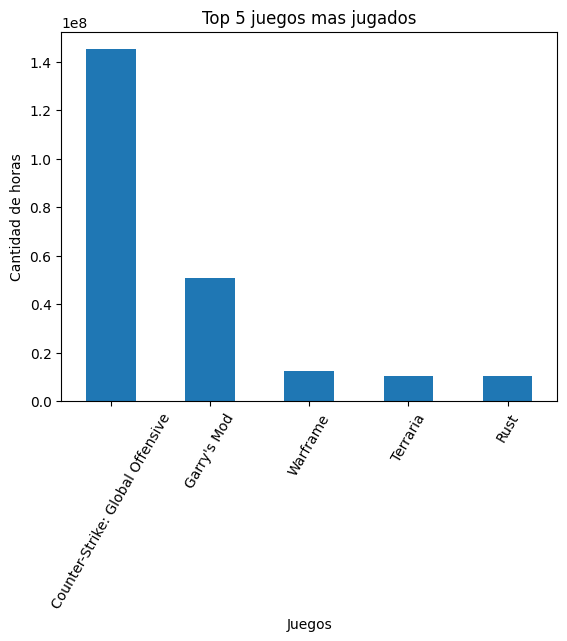

In [16]:
# Creamos el grafico
juegoMasJugado.plot(kind='bar')
plt.title('Top 5 juegos mas jugados')
plt.xlabel('Juegos')
plt.ylabel('Cantidad de horas')
plt.xticks(rotation=60)
plt.show()

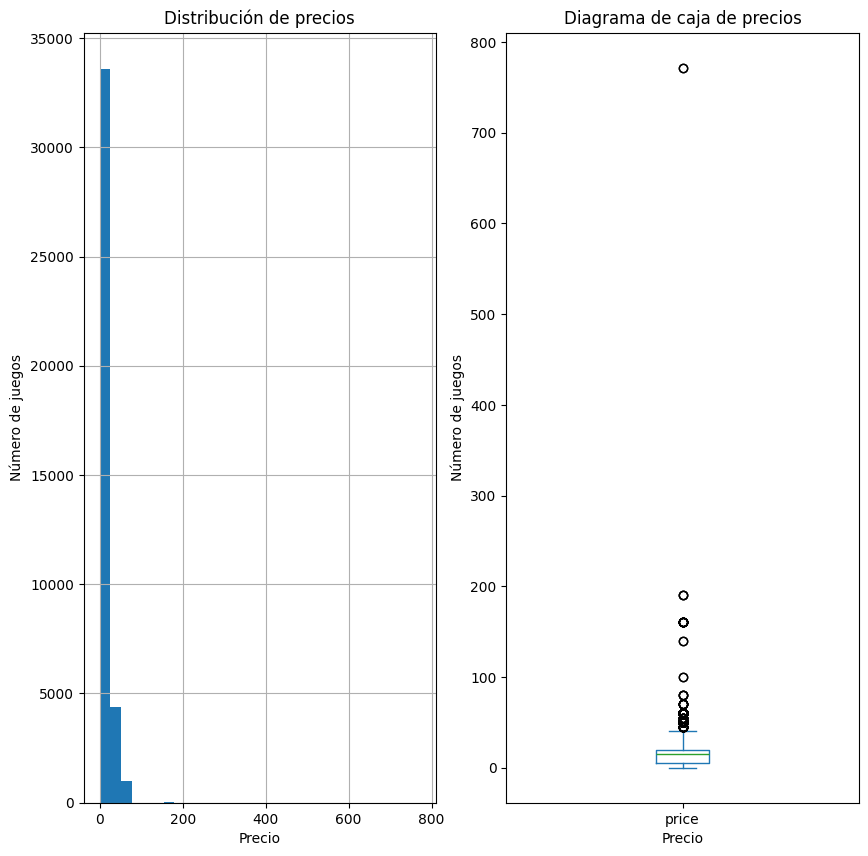

In [23]:
plt.subplot(1,2,1)
df['price'].hist(bins=30, figsize=(10, 10))
plt.title('Distribución de precios')
plt.xlabel('Precio')
plt.ylabel('Número de juegos')

plt.subplot(1,2,2)
df['price'].plot.box()
plt.title('Diagrama de caja de precios')
plt.xlabel('Precio')
plt.ylabel('Número de juegos')

plt.show()

In [24]:
# Agregar columnas al dataset para poder hacer el recuento de cada genero

#Vemos todos los generos de los juegos que tenemos
listaDeGeneros = []
for generos in df['genres']:
  for genero in generos:
    if genero not in listaDeGeneros:
      listaDeGeneros.append(genero)

# Los inicializamos en 0
df[listaDeGeneros] = 0

# Aplicamos un 1 en cada uno a cada juego que pertenece a X genero.
for indice, generos in enumerate(df['genres']):
  for genero in generos:
    df[genero].iloc[indice] = 1

#Guardamos los datos en otro dataframe para que quede mas ordenado.
generos = []
cantidad = []
for genero in listaDeGeneros:
    generos.append(genero)
    cantidad.append(df[genero].value_counts()[1])

juegos = pd.DataFrame()
juegos['Genero'] = generos
juegos['Cantidad'] = cantidad

C:\Users\toffer\AppData\Local\Temp\ipykernel_20348\3589570085.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[genero].iloc[indice] = 1
C:\Users\toffer\AppData\Local\Temp\ipykernel_20348\3589570085.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[genero].iloc[indice] = 1
C:\Users\toffer\AppData\Local\Temp\ipykernel_20348\3589570085.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[genero].iloc[indice] = 1
C:\Users\t

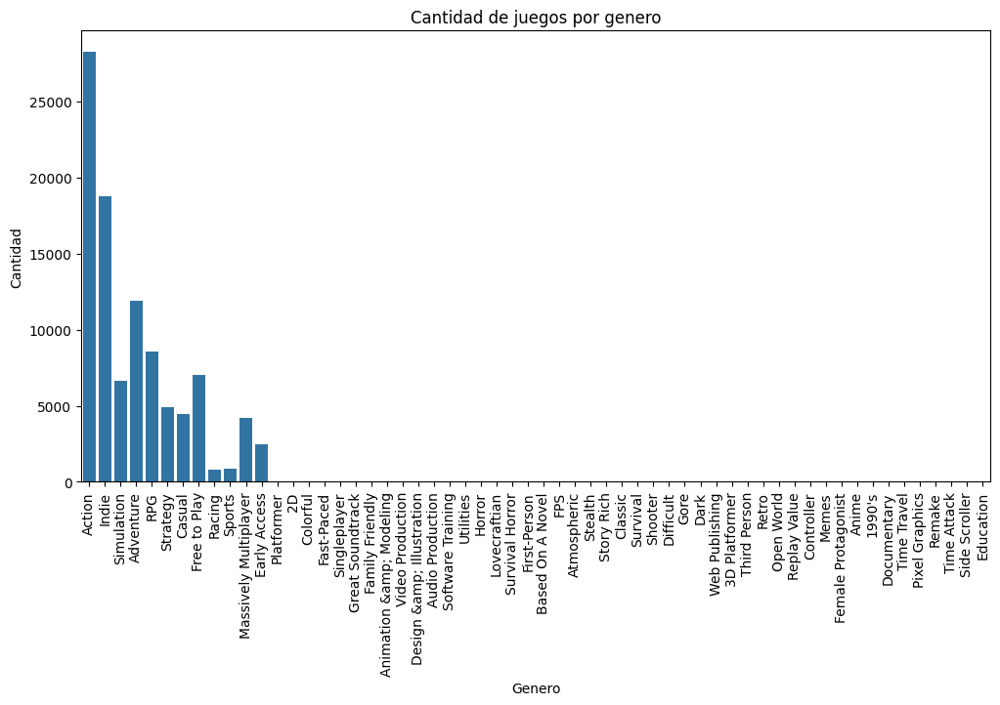

In [25]:
plt.figure(figsize=(12, 6)) 
sns.barplot(data=juegos, x='Genero', y='Cantidad')
plt.title('Cantidad de juegos por genero')
plt.xticks(rotation=90)
plt.show()

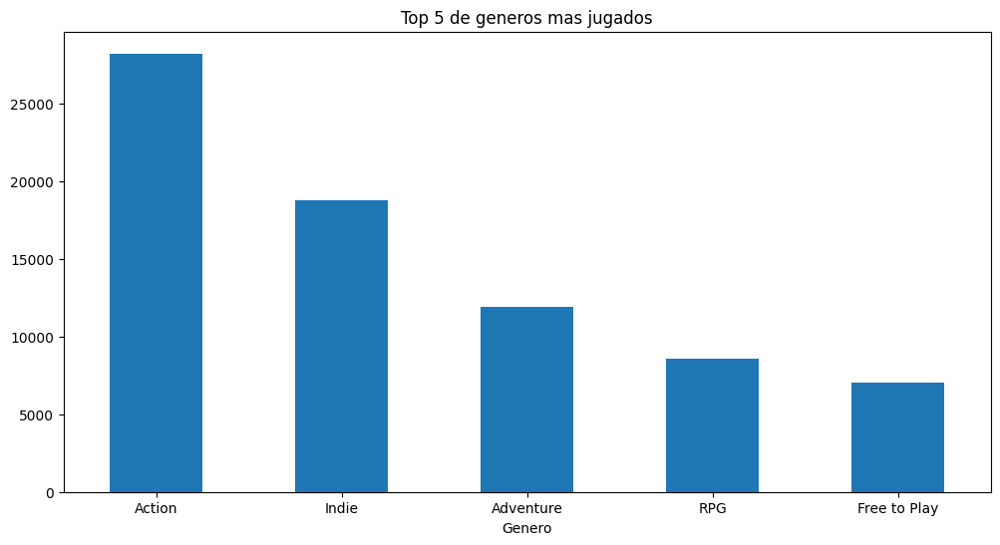

In [26]:
juegos = juegos.groupby('Genero').sum()['Cantidad'].sort_values(ascending=False).head(5)

# Graficamos
plt.figure(figsize=(12, 6)) 
juegos.plot(kind='bar')
plt.title('Top 5 de generos mas jugados')
plt.xticks(rotation=0)
plt.show()


df.drop(columns=listaDeGeneros, inplace=True)

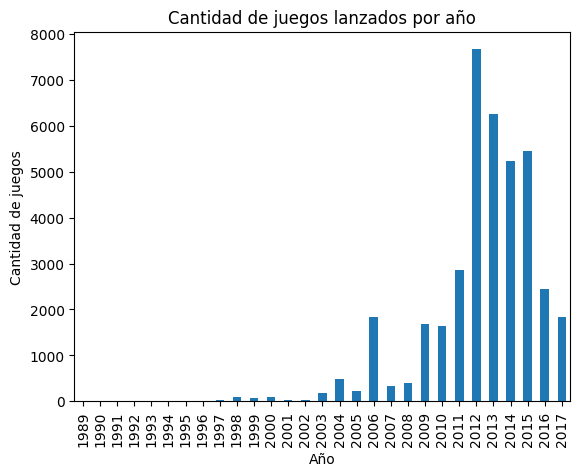

In [27]:
juegosPorAño = df['release_date'].value_counts().sort_index()
juegosPorAño.plot(kind='bar')
plt.title('Cantidad de juegos lanzados por año')
plt.xlabel('Año')
plt.ylabel('Cantidad de juegos')
plt.xticks(rotation=90)
plt.show()

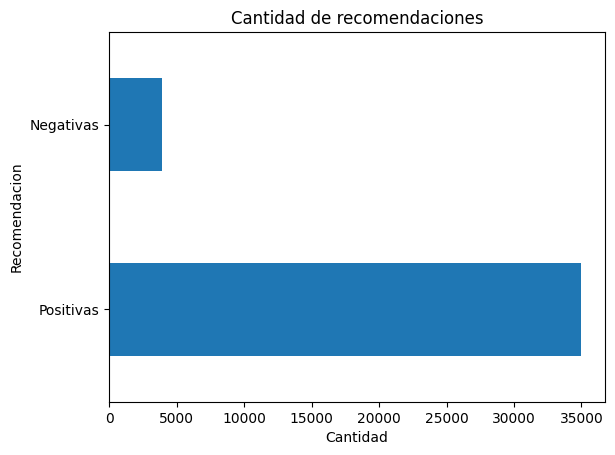

In [28]:
df['recommend'].value_counts().plot(kind='barh')
plt.title('Cantidad de recomendaciones')
plt.xlabel('Cantidad')
plt.ylabel('Recomendacion')
plt.yticks(ticks=[0,1],labels=['Positivas','Negativas'])
plt.show()

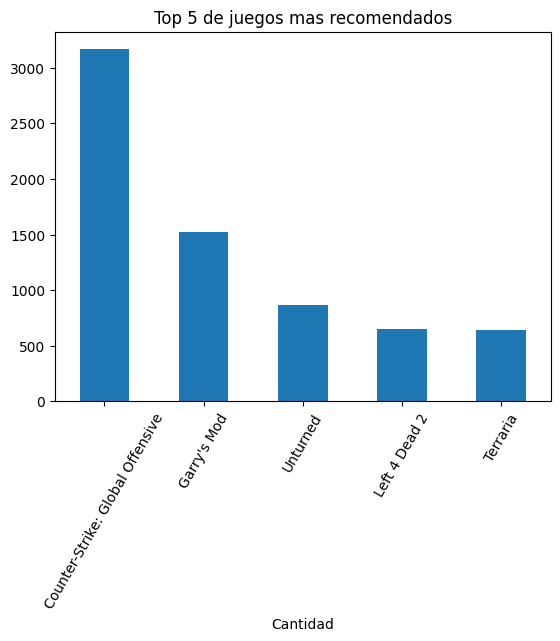

In [29]:
juegosRecomend = df[['item_name', 'recommend']].groupby('item_name')['recommend'].sum().sort_values(ascending=False).head(5)
juegosRecomend.plot(kind='bar')
plt.title('Top 5 de juegos mas recomendados')
plt.xlabel('Cantidad')
plt.xticks(rotation = 60)
plt.show()

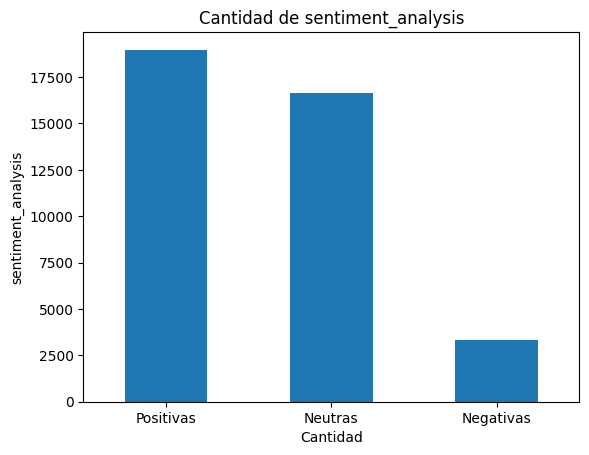

In [30]:
df['sentiment_analysis'].value_counts().plot(kind='bar')
plt.title('Cantidad de sentiment_analysis')
plt.xlabel('Cantidad')
plt.ylabel('sentiment_analysis')
plt.xticks(rotation = 0 ,ticks=[0,1,2],labels=['Positivas','Neutras','Negativas'])
plt.show()

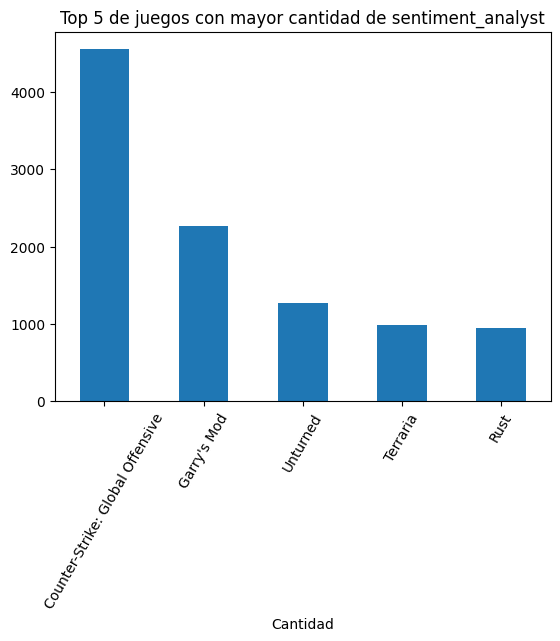

In [31]:
juegosAnalysis = df[['item_name', 'sentiment_analysis']].groupby('item_name')['sentiment_analysis'].sum().sort_values(ascending=False).head(5)
juegosAnalysis.plot(kind='bar')
juegosAnalysis
plt.title('Top 5 de juegos con mayor cantidad de sentiment_analyst')
plt.xlabel('Cantidad')
plt.xticks(rotation = 60)
plt.show()